# Наблюдаем ли мы глобальное потепление?

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly.offline as py
import plotly.express as px
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.tools as tls
from plotly.subplots import make_subplots
import seaborn as sns
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.stattools import adfuller

Данные доступны по ссылке:
https://www.kaggle.com/datasets/berkeleyearth/climate-change-earth-surface-temperature-data

## 1. Чтение данных

In [2]:
temp_country = pd.read_csv('GlobalLandTemperaturesByCountry.csv')
temp_country.head(10)

,dt,AverageTemperature,AverageTemperatureUncertainty,Country
0,1743-11-01,4.384,2.294,Åland
1,1743-12-01,NaN,NaN,Åland
2,1744-01-01,NaN,NaN,Åland
3,1744-02-01,NaN,NaN,Åland
4,1744-03-01,NaN,NaN,Åland
5,1744-04-01,1.530,4.680,Åland
6,1744-05-01,6.702,1.789,Åland
7,1744-06-01,11.609,1.577,Åland
8,1744-07-01,15.342,1.410,Åland
9,1744-08-01,NaN,NaN,Åland


In [3]:
temp_country.Country.unique()

array(['Åland', 'Afghanistan', 'Africa', 'Albania', 'Algeria',
       'American Samoa', 'Andorra', 'Angola', 'Anguilla', 'Antarctica',
       'Antigua And Barbuda', 'Argentina', 'Armenia', 'Aruba', 'Asia',
       'Australia', 'Austria', 'Azerbaijan', 'Bahamas', 'Bahrain',
       'Baker Island', 'Bangladesh', 'Barbados', 'Belarus', 'Belgium',
       'Belize', 'Benin', 'Bhutan', 'Bolivia',
       'Bonaire, Saint Eustatius And Saba', 'Bosnia And Herzegovina',
       'Botswana', 'Brazil', 'British Virgin Islands', 'Bulgaria',
       'Burkina Faso', 'Burma', 'Burundi', "Côte D'Ivoire", 'Cambodia',
       'Cameroon', 'Canada', 'Cape Verde', 'Cayman Islands',
       'Central African Republic', 'Chad', 'Chile', 'China',
       'Christmas Island', 'Colombia', 'Comoros',
       'Congo (Democratic Republic Of The)', 'Congo', 'Costa Rica',
       'Croatia', 'Cuba', 'Curaçao', 'Cyprus', 'Czech Republic',
       'Denmark (Europe)', 'Denmark', 'Djibouti', 'Dominica',
       'Dominican Republic', 'Ecu

In [4]:
temp_country.shape

(577462, 4)

In [5]:
temp_state = pd.read_csv('GlobalLandTemperaturesByState.csv')
temp_state.head(10)

,dt,AverageTemperature,AverageTemperatureUncertainty,State,Country
0,1855-05-01,25.544,1.171,Acre,Brazil
1,1855-06-01,24.228,1.103,Acre,Brazil
2,1855-07-01,24.371,1.044,Acre,Brazil
3,1855-08-01,25.427,1.073,Acre,Brazil
4,1855-09-01,25.675,1.014,Acre,Brazil
5,1855-10-01,25.442,1.179,Acre,Brazil
6,1855-11-01,25.400,1.064,Acre,Brazil
7,1855-12-01,24.100,1.718,Acre,Brazil
8,1856-01-01,25.814,1.159,Acre,Brazil
9,1856-02-01,24.658,1.147,Acre,Brazil


In [6]:
temp_state.shape

(645675, 5)

In [7]:
temp_state.Country.unique()

array(['Brazil', 'Russia', 'United States', 'Canada', 'India', 'China',
       'Australia'], dtype=object)

In [8]:
temp_state.State.unique()

array(['Acre', 'Adygey', 'Aga Buryat', 'Alabama', 'Alagoas', 'Alaska',
       'Alberta', 'Altay', 'Amazonas', 'Amur', 'Andaman And Nicobar',
       'Andhra Pradesh', 'Anhui', 'Arizona', 'Arkansas', "Arkhangel'Sk",
       'Arunachal Pradesh', 'Assam', "Astrakhan'",
       'Australian Capital Territory', 'Bahia', 'Bashkortostan',
       'Beijing', 'Belgorod', 'Bihar', 'British Columbia', 'Bryansk',
       'Buryat', 'California', 'Chandigarh', 'Chechnya', 'Chelyabinsk',
       'Chhattisgarh', 'Chita', 'Chongqing', 'Chukot', 'Chuvash',
       'City Of St. Petersburg', 'Colorado', 'Connecticut',
       'Dadra And Nagar Haveli', 'Dagestan', 'Daman And Diu', 'Delaware',
       'Delhi', 'District Of Columbia', 'Distrito Federal', 'Evenk',
       'Florida', 'Fujian', 'Gansu', 'Georgia (State)', 'Goa',
       'Gorno Altay', 'Guangdong', 'Guangxi', 'Guizhou', 'Gujarat',
       'Hainan', 'Haryana', 'Hawaii', 'Hebei', 'Heilongjiang', 'Henan',
       'Himachal Pradesh', 'Hubei', 'Hunan', 'Idaho', 'I

In [9]:
temp_majorcity = pd.read_csv('GlobalLandTemperaturesByMajorCity.csv')
temp_majorcity.head(10)

,dt,AverageTemperature,AverageTemperatureUncertainty,City,Country,Latitude,Longitude
0,1849-01-01,26.704,1.435,Abidjan,Côte D'Ivoire,5.63N,3.23W
1,1849-02-01,27.434,1.362,Abidjan,Côte D'Ivoire,5.63N,3.23W
2,1849-03-01,28.101,1.612,Abidjan,Côte D'Ivoire,5.63N,3.23W
3,1849-04-01,26.140,1.387,Abidjan,Côte D'Ivoire,5.63N,3.23W
4,1849-05-01,25.427,1.200,Abidjan,Côte D'Ivoire,5.63N,3.23W
5,1849-06-01,24.844,1.402,Abidjan,Côte D'Ivoire,5.63N,3.23W
6,1849-07-01,24.058,1.254,Abidjan,Côte D'Ivoire,5.63N,3.23W
7,1849-08-01,23.576,1.265,Abidjan,Côte D'Ivoire,5.63N,3.23W
8,1849-09-01,23.662,1.226,Abidjan,Côte D'Ivoire,5.63N,3.23W
9,1849-10-01,25.263,1.175,Abidjan,Côte D'Ivoire,5.63N,3.23W


In [10]:
temp_majorcity.shape

(239177, 7)

In [11]:
temp_majorcity.City.unique()

array(['Abidjan', 'Addis Abeba', 'Ahmadabad', 'Aleppo', 'Alexandria',
       'Ankara', 'Baghdad', 'Bangalore', 'Bangkok', 'Belo Horizonte',
       'Berlin', 'Bogotá', 'Bombay', 'Brasília', 'Cairo', 'Calcutta',
       'Cali', 'Cape Town', 'Casablanca', 'Changchun', 'Chengdu',
       'Chicago', 'Chongqing', 'Dakar', 'Dalian', 'Dar Es Salaam',
       'Delhi', 'Dhaka', 'Durban', 'Faisalabad', 'Fortaleza', 'Gizeh',
       'Guangzhou', 'Harare', 'Harbin', 'Ho Chi Minh City', 'Hyderabad',
       'Ibadan', 'Istanbul', 'Izmir', 'Jaipur', 'Jakarta', 'Jiddah',
       'Jinan', 'Kabul', 'Kano', 'Kanpur', 'Karachi', 'Kiev', 'Kinshasa',
       'Lagos', 'Lahore', 'Lakhnau', 'Lima', 'London', 'Los Angeles',
       'Luanda', 'Madras', 'Madrid', 'Manila', 'Mashhad', 'Melbourne',
       'Mexico', 'Mogadishu', 'Montreal', 'Moscow', 'Nagoya', 'Nagpur',
       'Nairobi', 'Nanjing', 'New Delhi', 'New York', 'Paris', 'Peking',
       'Pune', 'Rangoon', 'Rio De Janeiro', 'Riyadh', 'Rome', 'São Paulo',
       'S

In [12]:
temp_city = pd.read_csv('GlobalLandTemperaturesByCity.csv')
temp_city.head(10)

,dt,AverageTemperature,AverageTemperatureUncertainty,City,Country,Latitude,Longitude
0,1743-11-01,6.068,1.737,Århus,Denmark,57.05N,10.33E
1,1743-12-01,NaN,NaN,Århus,Denmark,57.05N,10.33E
2,1744-01-01,NaN,NaN,Århus,Denmark,57.05N,10.33E
3,1744-02-01,NaN,NaN,Århus,Denmark,57.05N,10.33E
4,1744-03-01,NaN,NaN,Århus,Denmark,57.05N,10.33E
5,1744-04-01,5.788,3.624,Århus,Denmark,57.05N,10.33E
6,1744-05-01,10.644,1.283,Århus,Denmark,57.05N,10.33E
7,1744-06-01,14.051,1.347,Århus,Denmark,57.05N,10.33E
8,1744-07-01,16.082,1.396,Århus,Denmark,57.05N,10.33E
9,1744-08-01,NaN,NaN,Århus,Denmark,57.05N,10.33E


In [13]:
temp_city.shape

(8599212, 7)

In [14]:
temp_city.City.nunique()

3448

In [36]:
global_temp = pd.read_csv('GlobalTemperatures.csv')
global_temp.head(10)

,dt,LandAverageTemperature,LandAverageTemperatureUncertainty,LandMaxTemperature,LandMaxTemperatureUncertainty,LandMinTemperature,LandMinTemperatureUncertainty,LandAndOceanAverageTemperature,LandAndOceanAverageTemperatureUncertainty
0,1750-01-01,3.034,3.574,NaN,NaN,NaN,NaN,NaN,NaN
1,1750-02-01,3.083,3.702,NaN,NaN,NaN,NaN,NaN,NaN
2,1750-03-01,5.626,3.076,NaN,NaN,NaN,NaN,NaN,NaN
3,1750-04-01,8.490,2.451,NaN,NaN,NaN,NaN,NaN,NaN
4,1750-05-01,11.573,2.072,NaN,NaN,NaN,NaN,NaN,NaN
5,1750-06-01,12.937,1.724,NaN,NaN,NaN,NaN,NaN,NaN
6,1750-07-01,15.868,1.911,NaN,NaN,NaN,NaN,NaN,NaN
7,1750-08-01,14.750,2.231,NaN,NaN,NaN,NaN,NaN,NaN
8,1750-09-01,11.413,2.637,NaN,NaN,NaN,NaN,NaN,NaN
9,1750-10-01,6.367,2.668,NaN,NaN,NaN,NaN,NaN,NaN


In [16]:
global_temp.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3192 entries, 0 to 3191
Data columns (total 9 columns):
 #   Column                                     Non-Null Count  Dtype  
---  ------                                     --------------  -----  
 0   dt                                         3192 non-null   object 
 1   LandAverageTemperature                     3180 non-null   float64
 2   LandAverageTemperatureUncertainty          3180 non-null   float64
 3   LandMaxTemperature                         1992 non-null   float64
 4   LandMaxTemperatureUncertainty              1992 non-null   float64
 5   LandMinTemperature                         1992 non-null   float64
 6   LandMinTemperatureUncertainty              1992 non-null   float64
 7   LandAndOceanAverageTemperature             1992 non-null   float64
 8   LandAndOceanAverageTemperatureUncertainty  1992 non-null   float64
dtypes: float64(8), object(1)
memory usage: 224.6+ KB


In [17]:
global_temp.shape

(3192, 9)

<Axes: >

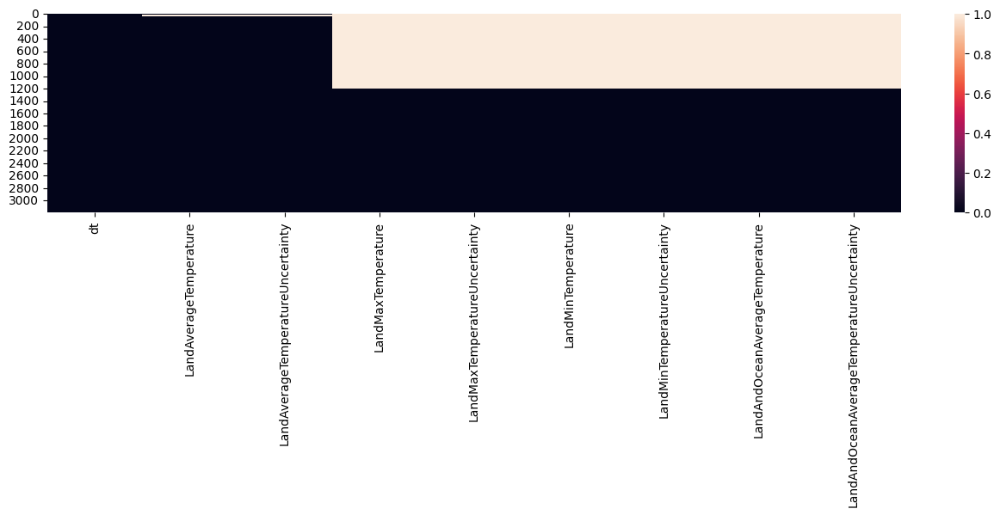

In [18]:
# Missing values
global_temp.isna().sum()
plt.figure(figsize = (16, 3))
sns.heatmap(global_temp.isna())

около 1200 пропущенных значений Max, Min и Land&Ocean Average Temp

## 2. Графики для разных климатических поясов
Нарисуем несколько графиков температуры для станций из разных климатических поясов

Для каждого климатического пояса найдем сответствующий ему город. Извлечем год из даты. Дальше будем считать для каждого пояса среднюю температуру за каждый имеющийся год.

In [19]:
years = np.unique(temp_city['dt'].apply(lambda x: x[:4]))
climate_zone_city = {'tropical':'Rio De Janeiro', 'subtropical': 'Sydney', 'temperate': 'Paris', 'subpolar and polar':'Murmansk'}
mean_temp_year_zone = [ [0] * len(years) for i in range(len(climate_zone_city))]
j = 0
for zone in climate_zone_city.keys():
    all_temp_zone = temp_city[temp_city['City'] == climate_zone_city[zone]]
    i = 0
    for year in years:
        mean_temp_year_zone[j][i] = all_temp_zone[all_temp_zone['dt'].apply(
                lambda x: x[:4]) == year]['AverageTemperature'].mean()
        i +=1
    j += 1

traces = []
for  idx,zone in enumerate(climate_zone_city.keys()):
    traces.append(go.Scatter(
        x=years,
        y=mean_temp_year_zone[idx],
        mode='lines',
        name=zone,
    ))

layout = go.Layout(
    xaxis=dict(title='year'),
    yaxis=dict(title='Average Temperature, °C'),
    title='Average land temperature on the climate zones',)

fig = go.Figure(data=traces, layout=layout)
py.iplot(fig)

Из графика видно, что есть пропущенные значения температуры за некоторые периоды времени.

## 3. Описательный анализ данных

### Статистика по температуре земли и океана

In [20]:
# Figure layout
fig = make_subplots(rows=2, cols=2,
                    subplot_titles=('Land Avg Temp', 'Land Min Temp', 'Land Max Temp','Land&Ocean Avg Temp'))
fig.update_layout(title="Global Temperatures", showlegend=False)

# Figure data
fig.add_trace(go.Box(x = global_temp['LandAverageTemperature'], boxpoints = 'all',jitter = 0.3, 
                     pointpos = -1.6, boxmean = True),
             row = 1, col = 1)
fig.add_trace(go.Box(x = global_temp['LandMinTemperature'],boxpoints = 'all',jitter = 0.3, 
                     pointpos = -1.6, boxmean = True),
             row = 1, col = 2)
fig.add_trace(go.Box(x = global_temp['LandMaxTemperature'], boxpoints = 'all',jitter = 0.3, 
                     pointpos = -1.6, boxmean = True),
             row = 2, col = 1)
fig.add_trace(go.Box(x = global_temp['LandAndOceanAverageTemperature'], boxpoints = 'all',jitter = 0.3, 
                     pointpos = -1.6, boxmean = True),
             row = 2, col = 2)

### Топ-10 самых жарких и самых холодных стран

C:\Users\karlo\AppData\Local\Temp\ipykernel_17104\2047745266.py:7: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




Text(0, 0.5, 'Country')

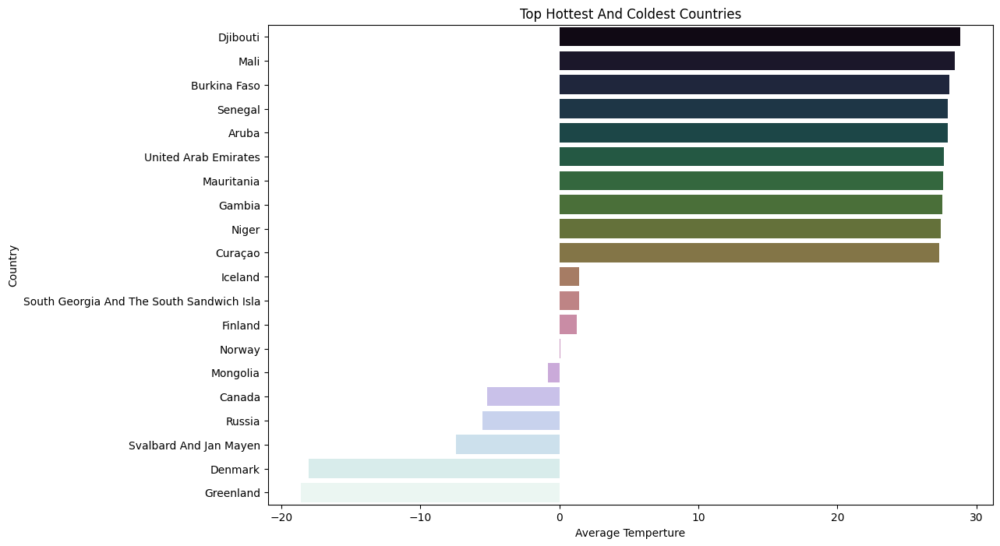

In [21]:
temp_country1=temp_country.groupby(['Country'])['AverageTemperature'].mean().reset_index()
hot=temp_country1.sort_values(by='AverageTemperature',ascending=False)[:10]
cold=temp_country1.sort_values(by='AverageTemperature',ascending=True)[:10]
top_countries=pd.concat([hot,cold])
top_countries.sort_values('AverageTemperature',ascending=False,inplace=True)
f,ax=plt.subplots(figsize=(12,8))
sns.barplot(y='Country',x='AverageTemperature',data=top_countries,palette='cubehelix',ax=ax).set_title('Top Hottest And Coldest Countries')
plt.xlabel('Average Temperture')
plt.ylabel('Country')


Посмотрим на сезонную температуру во всем мире

In [29]:
global_temp1 = global_temp.copy()
global_temp1['dt'] = pd.to_datetime(global_temp1['dt'])
global_temp1['year'] = global_temp1['dt'].map(lambda x: x.year)
global_temp1['month'] = global_temp1['dt'].map(lambda x: x.month)

def get_season(month):
    if month >= 3 and month <= 5:
        return 'spring'
    elif month >= 6 and month <= 8:
        return 'summer'
    elif month >= 9 and month <= 11:
        return 'autumn'
    else:
        return 'winter'
    
min_year = global_temp1['year'].min()
max_year = global_temp1['year'].max()
years = np.arange(min_year, max_year + 1)

global_temp1['season'] = global_temp1['month'].apply(get_season)

spring_temps = []
summer_temps = []
autumn_temps = []
winter_temps = []

for year in years:
    curr_years_data = global_temp1[global_temp1['year'] == year]
    spring_temps.append(curr_years_data[curr_years_data['season'] == 'spring']['LandAverageTemperature'].mean())
    summer_temps.append(curr_years_data[curr_years_data['season'] == 'summer']['LandAverageTemperature'].mean())
    autumn_temps.append(curr_years_data[curr_years_data['season'] == 'autumn']['LandAverageTemperature'].mean())
    winter_temps.append(curr_years_data[curr_years_data['season'] == 'winter']['LandAverageTemperature'].mean())

In [30]:
seasons = ['summer', 'autumn', 'spring', 'winter']
season_temps = [summer_temps, autumn_temps, spring_temps, winter_temps]
traces = []
for i in range(len(seasons)):
    traces.append(go.Scatter(
        x=years,
        y=season_temps[i],
        mode='lines',
        name=seasons[i],
    ))

layout = go.Layout(
    xaxis=dict(title='year'),
    yaxis=dict(title='Average Temperature, °C'),
    title='Average temperature in each season',)

fig = go.Figure(data=traces, layout=layout)
py.iplot(fig)

## 4. Матрица корреляций

<Axes: >

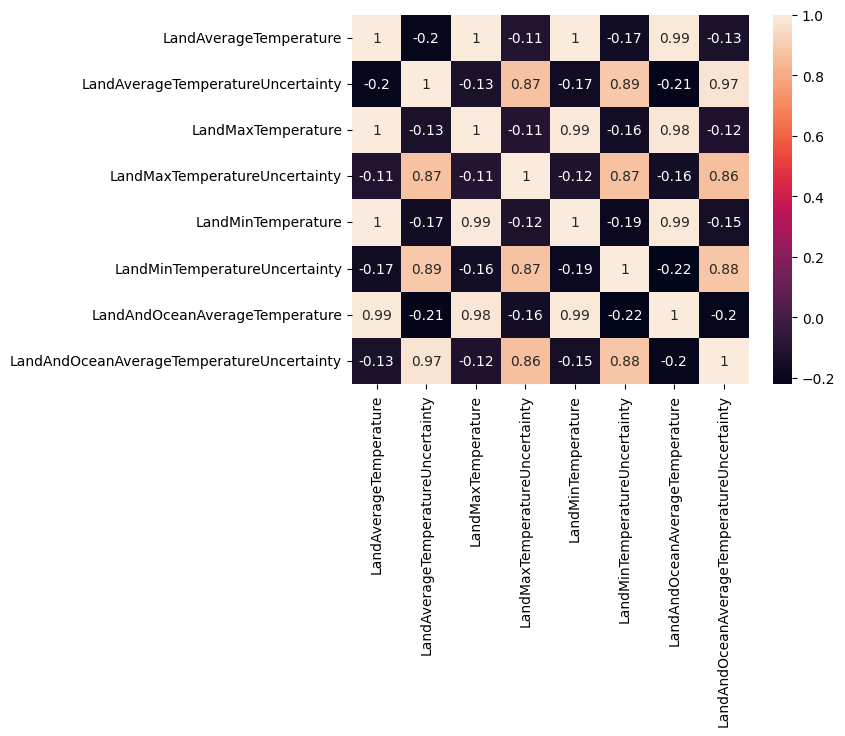

In [31]:
sns.heatmap(global_temp.corr(numeric_only=True), annot=True)

Видно, что многие признаки коррелируют между собой, например, средняя температура суши коррелирует со средней температурой суши и окена.

## 5. Изучение коррелирующих величин

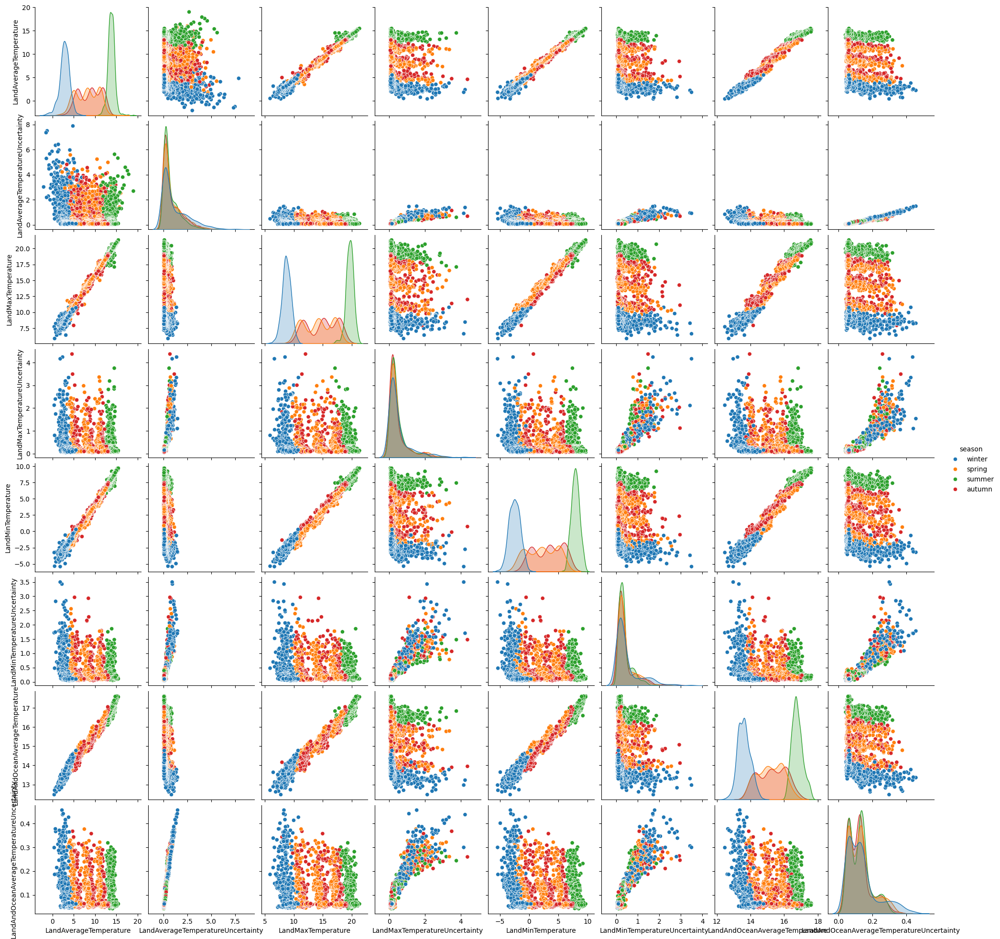

In [32]:
sns.pairplot(global_temp1.drop(columns=['year', 'month']), hue='season')

Из paiplot-a видно, что у высокоскоррелированных признаков (средняя и максимальная температуры суши, средняя и минимальная температуры суши, средние температуры суши и суши&океана, максимальная и минимальная температуры суши, максимальная температура суши и средняя температура суши&океана, миниимальная температура суши и средняя температура суши&океана) линейный характер зависимости.

## 6. Работа с пустыми значениями

Как уже было замечено ранее, в датасете есть пропущенные данные. Чтобы дальше можно было с временными рядам, нужно заполнить пропущенные значения. Сделаем это интерполяцией по времени.

In [38]:
global_temp2 = global_temp.copy()
global_temp2['dt'] = pd.to_datetime(global_temp2.dt) # меняем тип колонки dt на datetime
global_temp2['year'] = global_temp2['dt'].dt.year

global_temp2 = global_temp2.set_index('dt') # делаем колонку dt индексом
global_temp2 = global_temp2.interpolate(method='time') # интерполяция пропущенных значений



# Для дальнейшего анализа будем использовать только колонку с годом (поскольку отсутствуют даты).
global_temp_yearly = global_temp2.groupby(by = 'year')[['LandAverageTemperature', 'LandAverageTemperatureUncertainty',
       'LandMaxTemperature', 'LandMaxTemperatureUncertainty',
       'LandMinTemperature', 'LandMinTemperatureUncertainty',
       'LandAndOceanAverageTemperature',
       'LandAndOceanAverageTemperatureUncertainty']].mean()#.reset_index()

## 7. Выбросы в данных

In [40]:
# Figure layout
fig = make_subplots(rows=2, cols=2,
                    subplot_titles=('Land Avg Temp', 'Land Min Temp', 'Land Max Temp','Land&Ocean Avg Temp'))
fig.update_layout(title="Global Temperatures", showlegend=False)

# Figure data
fig.add_trace(go.Box(x = global_temp_yearly['LandAverageTemperature'], boxmean = True),
             row = 1, col = 1)
fig.add_trace(go.Box(x = global_temp_yearly['LandMinTemperature'], boxmean = True),
             row = 1, col = 2)
fig.add_trace(go.Box(x = global_temp_yearly['LandMaxTemperature'], boxmean = True),
             row = 2, col = 1)
fig.add_trace(go.Box(x = global_temp_yearly['LandAndOceanAverageTemperature'], boxmean = True),
             row = 2, col = 2)

Есть выбросы по средней температуре суши, максимальной температуре суши, средней температуре суши&океана.

In [41]:
# Вычисление границ IQR
Q1, Q3 = global_temp_yearly['LandAverageTemperature'].quantile([0.25, 0.75])
IQR = Q3 - Q1
bottom, top = Q1 - 1.5 * IQR, Q3 + 1.5 * IQR  

# Отсеивание выбросов
global_temp_yearly = global_temp_yearly[(global_temp_yearly['LandAverageTemperature'] >= bottom) & (global_temp_yearly['LandAverageTemperature'] <= top)]

In [42]:
# Вычисление границ IQR
Q1, Q3 = global_temp_yearly['LandMaxTemperature'].quantile([0.25, 0.75])
IQR = Q3 - Q1
bottom, top = Q1 - 1.5 * IQR, Q3 + 1.5 * IQR  

# Отсеивание выбросов
global_temp_yearly = global_temp_yearly[(global_temp_yearly['LandMaxTemperature'] >= bottom) & (global_temp_yearly['LandMaxTemperature'] <= top)]

In [43]:
# Вычисление границ IQR
Q1, Q3 = global_temp_yearly['LandAndOceanAverageTemperature'].quantile([0.25, 0.75])
IQR = Q3 - Q1
bottom, top = Q1 - 1.5 * IQR, Q3 + 1.5 * IQR  

# Отсеивание выбросов
global_temp_yearly = global_temp_yearly[(global_temp_yearly['LandAndOceanAverageTemperature'] >= bottom) & (global_temp_yearly['LandAndOceanAverageTemperature'] <= top)]

In [44]:
# Figure layout
fig = make_subplots(rows=2, cols=2,
                    subplot_titles=('Land Avg Temp', 'Land Min Temp', 'Land Max Temp','Land&Ocean Avg Temp'))
fig.update_layout(title="Global Temperatures", showlegend=False)

# Figure data
fig.add_trace(go.Box(x = global_temp_yearly['LandAverageTemperature'], boxmean = True),
             row = 1, col = 1)
fig.add_trace(go.Box(x = global_temp_yearly['LandMinTemperature'], boxmean = True),
             row = 1, col = 2)
fig.add_trace(go.Box(x = global_temp_yearly['LandMaxTemperature'], boxmean = True),
             row = 2, col = 1)
fig.add_trace(go.Box(x = global_temp_yearly['LandAndOceanAverageTemperature'], boxmean = True),
             row = 2, col = 2)

Еще остались выбросы в максимальной температуре.

In [45]:
# Вычисление границ IQR
Q1, Q3 = global_temp_yearly['LandMaxTemperature'].quantile([0.25, 0.75])
IQR = Q3 - Q1
bottom, top = Q1 - 1.5 * IQR, Q3 + 1.5 * IQR  

# Отсеивание выбросов
global_temp_yearly = global_temp_yearly[(global_temp_yearly['LandMaxTemperature'] >= bottom) & (global_temp_yearly['LandMaxTemperature'] <= top)]

In [46]:
# Figure layout
fig = make_subplots(rows=2, cols=2,
                    subplot_titles=('Land Avg Temp', 'Land Min Temp', 'Land Max Temp','Land&Ocean Avg Temp'))
fig.update_layout(title="Global Temperatures", showlegend=False)

# Figure data
fig.add_trace(go.Box(x = global_temp_yearly['LandAverageTemperature'], boxmean = True),
             row = 1, col = 1)
fig.add_trace(go.Box(x = global_temp_yearly['LandMinTemperature'], boxmean = True),
             row = 1, col = 2)
fig.add_trace(go.Box(x = global_temp_yearly['LandMaxTemperature'], boxmean = True),
             row = 2, col = 1)
fig.add_trace(go.Box(x = global_temp_yearly['LandAndOceanAverageTemperature'], boxmean = True),
             row = 2, col = 2)

Выбросов больше нет

## 8. Гипотеза о потеплении

Построим график глобальной средней температуры

In [49]:
trace0 = go.Scatter(
    x = global_temp_yearly.index, 
    y = np.array(global_temp_yearly['LandAverageTemperature']) + np.array(global_temp_yearly['LandAverageTemperatureUncertainty']),
    fill= None,
    mode='lines',
    name='Uncertainty top',
    line=dict(
        color='rgb(0, 255, 255)',
    )
)
trace1 = go.Scatter(
    x = global_temp_yearly.index, 
    y = np.array(global_temp_yearly['LandAverageTemperature']) - np.array(global_temp_yearly['LandAverageTemperatureUncertainty']),
    fill='tonexty',
    mode='lines',
    name='Uncertainty bot',
    line=dict(
        color='rgb(0, 255, 255)',
    )
)

trace2 = go.Scatter(
    x = global_temp_yearly.index, 
    y = global_temp_yearly['LandAverageTemperature'],
    name='Average Temperature',
    line=dict(
        color='rgb(199, 121, 093)',
    )
)
data = [trace0, trace1, trace2]

layout = go.Layout(
    xaxis=dict(title='year'),
    yaxis=dict(title='Average Temperature, °C'),
    title='Average land temperature in the world',
    showlegend = False)

fig = go.Figure(data=data, layout=layout)
py.iplot(fig)

Из графика видно, что где-то в 1970-х годах средняя температра начала расти. И можно сделать вывод, что в настоящее время наблюдается глобальное потепление. Самый быстрый рост температуры произошел за последние 30 лет. На графике также есть доверительные интервалы, которые показывают, что за последние несколько лет измерение температуры стало более точным. Но давайте проверим это предположение статистическим тестом.

**Нулевая гипотеза ($H_0$)**: Средние значения температур не стационарны (имеют некоторую структуру, зависящую от времени). То есть средние значения температур за последние годы  отличаются от средних значений прошлых лет. Это означает наличие глобального потепления.

**Альтернативная гипотеза ($H_a$)**: Средние значения температур стационарны. То есть нет значимого изменения температуры со временем.

In [65]:
series = global_temp2['LandAverageTemperature']
result = seasonal_decompose(series, model='additive', period=12)
trend = result.trend.dropna()
seasonal = result.seasonal.dropna()
residual = result.resid.dropna()

# Figure layout
fig = make_subplots(rows=4, cols=1,
                        subplot_titles=('Original Series', 'Trend', 'Seasonality', 'Residuals'))
fig.update_layout(title=f"Average Temperature in the world decomposition ", showlegend=False)

# Figure data
fig.add_trace(go.Scatter(x=series.index,y=series, mode='lines',),
                row = 1, col = 1)
fig.add_trace(go.Scatter(x=trend.index,y=trend, mode='lines',),
                row = 2, col = 1)
fig.add_trace(go.Scatter(x=seasonal.index,y=seasonal, mode='lines', ),
                row = 3, col = 1)
fig.add_trace(go.Scatter(x=residual.index,y=residual, mode='lines', ),
                row = 4, col = 1)
fig.update_layout(height=900)
fig.show()

In [68]:
def test_smoothed_trend(window_size=10):
    series = global_temp2['LandAverageTemperature']
    result = seasonal_decompose(series, model='additive', period=12)
    trend = result.trend.dropna()
    adf_result = adfuller(trend)
    
    if adf_result[1] > 0.05:
        print(f'Нельзя отклонить H_0: временной ряд нестационарен (p-value={adf_result[1]:.3f})')
    else:
        print(f'Отклоненяем H_0: временной ряд является стационарным (p-value={adf_result[1]:.3f})')
        
test_smoothed_trend(20)

Отклоненяем H_0: временной ряд является стационарным (p-value=0.008)


**Вывод:** Получается, что в мире не наблюдается тренда на глобальное потепление.

Рассмотрим датасет, содержаший данные средней температуры в разных странах.

In [50]:
# Удалим дублирующиеся страны

temp_country_clear = temp_country[~temp_country['Country'].isin(
    ['Denmark', 'Antarctica', 'France', 'Europe', 'Netherlands',
     'United Kingdom', 'Africa', 'South America'])]

temp_country_clear = temp_country_clear.replace(
   ['Denmark (Europe)', 'France (Europe)', 'Netherlands (Europe)', 'United Kingdom (Europe)'],
   ['Denmark', 'France', 'Netherlands', 'United Kingdom'])

Разделим данные на отдельные временные ряды для каждой страны.

In [51]:
countries = temp_country_clear['Country'].unique()

country_data = {}
for country in countries:
    country_data[country] = temp_country_clear[temp_country_clear['Country']== country]

Построим графики временных рядов для нескольких городов.

In [52]:
fig = px.line(title="Average Tempreture in some countries")
for country in  [ 'Haiti', 'Uganda', 'Nepal', 'United States', 'Russia','Greenland']:
    fig.add_scatter(x=country_data[country]['dt'], y=country_data[country]['AverageTemperature'], name=country)
fig.show()


In [53]:
temp_country_clear['dt'] = pd.to_datetime(temp_country_clear['dt']) # меняем тип колонки dt на datetime
temp_country_clear = temp_country_clear.set_index('dt') # делаем колонку dt индексом
temp_country_clear = temp_country_clear.interpolate(method='time') # интерполяция пропущенных значений

countries = temp_country_clear['Country'].unique()

country_data = {}
for country in countries:
    country_data[country] = temp_country_clear[temp_country_clear['Country']== country]

fig = px.line(title="Average Tempreture in some countries")
for country in  [ 'Haiti', 'Uganda', 'Nepal', 'United States', 'Russia','Greenland']:
    fig.add_scatter(x=country_data[country].index, y=country_data[country]['AverageTemperature'], name=country)
fig.show()

C:\Users\karlo\AppData\Local\Temp\ipykernel_17104\2849949550.py:3: FutureWarning:

DataFrame.interpolate with object dtype is deprecated and will raise in a future version. Call obj.infer_objects(copy=False) before interpolating instead.



Используем декомпозицию временного ряда для выделения трендов и сезонных компонент. Используем 'addditive' модель, так как унас есть нулевые и отрицвтельные значения

In [54]:
def decompose_series(country):
    series = country_data[country]['AverageTemperature']
    
    result = seasonal_decompose(series, model='additive', period=12)
    trend = result.trend
    seasonal = result.seasonal
    residual = result.resid
    
    return trend, seasonal, residual

In [55]:
for country in  [ 'Haiti', 'Uganda', 'Nepal', 'United States', 'Russia','Greenland']:
    trend, seasonal, residual = decompose_series(country)

    # Figure layout
    fig = make_subplots(rows=4, cols=1,
                        subplot_titles=('Original Series', 'Trend', 'Seasonality', 'Residuals'))
    fig.update_layout(title=f"Average Temperatures decomposition  for {country}", showlegend=False)

    # Figure data
    fig.add_trace(go.Scatter(x=country_data[country].index,y=country_data[country]['AverageTemperature'], mode='lines',),
                row = 1, col = 1)
    fig.add_trace(go.Scatter(x=trend.index,y=trend, mode='lines',),
                row = 2, col = 1)
    fig.add_trace(go.Scatter(x=seasonal.index,y=seasonal, mode='lines', ),
                row = 3, col = 1)
    fig.add_trace(go.Scatter(x=residual.index,y=residual, mode='lines', ),
                row = 4, col = 1)
    fig.update_layout(height=900)
    fig.show()

Проверим наличие тренда с использованием Augmented Dickey-Fuller test.

In [56]:
def test_trend(country):
    #series = country_data[country]['AverageTemperature']
    trend, seasonal, residual = decompose_series(country)
    adf_result = adfuller(trend[6:-6])
    
    if adf_result[1] > 0.05:
        print(f'{country}: Нельзя отклонить H_0: временной ряд нестационарен (p-value={adf_result[1]:.3f})')
    else:
        print(f'{country}: Отклоненяем H_0: временной ряд является стационарным (p-value={adf_result[1]:.3f})')
        
for country in  [ 'Haiti', 'Uganda', 'Nepal', 'United States', 'Russia','Greenland']:
    test_trend(country)


Haiti: Отклоненяем H_0: временной ряд является стационарным (p-value=0.000)
Uganda: Отклоненяем H_0: временной ряд является стационарным (p-value=0.001)
Nepal: Отклоненяем H_0: временной ряд является стационарным (p-value=0.001)
United States: Отклоненяем H_0: временной ряд является стационарным (p-value=0.000)
Russia: Отклоненяем H_0: временной ряд является стационарным (p-value=0.000)
Greenland: Нельзя отклонить H_0: временной ряд нестационарен (p-value=0.366)


Средняя температура по нескольким странам

In [58]:
contries = [ 'Haiti', 'Uganda', 'Nepal', 'United States', 'Russia','Greenland']
years = np.unique(temp_country['dt'].apply(lambda x: x[:4]))
mean_temp_year_country = [ [0] * len(years[-39:]) for i in range(len(contries))]
j = 0
for country in contries:
    all_temp_country = temp_country[temp_country['Country'] == country]
    i = 0
    for year in years[-39:]:
        mean_temp_year_country[j][i] = all_temp_country[all_temp_country['dt'].apply(
                lambda x: x[:4]) == year]['AverageTemperature'].mean()
        i +=1
    j += 1

traces = []
for i in range(len(contries)):
    traces.append(go.Scatter(
        x=years[-39:],
        y=mean_temp_year_country[i],
        mode='lines',
        name=contries[i],
    ))

layout = go.Layout(
    xaxis=dict(title='year'),
    yaxis=dict(title='Average Temperature, °C'),
    title='Average land temperature in some contries for the last 100 years',)

fig = go.Figure(data=traces, layout=layout)
fig.update_layout(height=1000,)
fig.update_yaxes(minor=dict(showgrid=True, gridwidth=1))
py.iplot(fig)

**Вывод:** Oсобенно сильную динамику можно наблюдать в странах с холодным климатом. В Гренладии наблюдается глобальное потепление.

## 9. Сглаживание и повторная проверка тренда

Применим скользящее среднее для сглаживания данных и устранения случайных колебаний.

In [69]:
series = global_temp2['LandAverageTemperature']
smoothed = series.rolling(window=50).mean()
fig = go.Figure()
fig.add_trace(go.Scatter(x=series.index, y=series, mode='lines', name='Original Data'))
fig.add_trace(go.Scatter(x=smoothed.index, y=smoothed, mode='lines', name='Moving Average'))
fig.update_layout(title='Average Temperature in the world smoothed', xaxis_title='Year', yaxis_title='AverageTemperature')
fig.show()

In [70]:
def test_smoothed_trend(window_size=20):
    series = global_temp2['LandAverageTemperature']
    smoothed = series.rolling(window=window_size).mean()
    result = seasonal_decompose(smoothed.dropna(), model='additive', period=12)
    trend = result.trend.dropna()
    adf_result = adfuller(trend)
    
    if adf_result[1] > 0.05:
        print(f'Нельзя отклонить H_0: временной ряд нестационарен (p-value={adf_result[1]:.3f})')
    else:
        print(f'Отклоненяем H_0: временной ряд является стационарным (p-value={adf_result[1]:.3f})')
        
test_smoothed_trend(20)

Нельзя отклонить H_0: временной ряд нестационарен (p-value=0.340)


**Вывод:** После сглаживания глобальное потепление стало наблюдаться во всем мире.

In [59]:
def smooth_series(country, window_size=10):
    series = country_data[country]['AverageTemperature']
    smoothed = series.rolling(window=window_size).mean()
    return smoothed

In [60]:
for country in  [ 'Haiti', 'Uganda', 'Nepal', 'United States', 'Russia','Greenland']:
    smoothed = smooth_series(country, 20)

    fig = go.Figure()
    fig.add_trace(go.Scatter(x=country_data[country].index, y=country_data[country]['AverageTemperature'], mode='lines', name='Original Data'))
    fig.add_trace(go.Scatter(x=smoothed.index, y=smoothed, mode='lines', name='Moving Average'))
    fig.update_layout(title=f'Average Temperature smoothed for {country}', xaxis_title='Year', yaxis_title='AverageTemperature')
    fig.show()

In [61]:
def test_smoothed_trend(country, window_size=10):
    series = country_data[country]['AverageTemperature']
    smoothed = series.rolling(window=window_size).mean()
    result = seasonal_decompose(smoothed.dropna(), model='additive', period=12)
    trend = result.trend.dropna()
    adf_result = adfuller(trend)
    
    if adf_result[1] > 0.05:
        print(f'{country}: Нельзя отклонить H_0: временной ряд нестационарен (p-value={adf_result[1]:.3f})')
    else:
        print(f'{country}: Отклоненяем H_0: временной ряд является стационарным (p-value={adf_result[1]:.3f})')
        
for country in  [ 'Haiti', 'Uganda', 'Nepal', 'United States', 'Russia','Greenland']:
    test_smoothed_trend(country)


Haiti: Отклоненяем H_0: временной ряд является стационарным (p-value=0.019)
Uganda: Отклоненяем H_0: временной ряд является стационарным (p-value=0.003)
Nepal: Отклоненяем H_0: временной ряд является стационарным (p-value=0.005)
United States: Отклоненяем H_0: временной ряд является стационарным (p-value=0.006)
Russia: Отклоненяем H_0: временной ряд является стационарным (p-value=0.000)
Greenland: Нельзя отклонить H_0: временной ряд нестационарен (p-value=0.550)


**Вывод:** После сглаживания, нлобальное потепление наблюдается снова только в Гренладии.

## Графики карты

In [71]:
# Удалим дублирующиеся страны и страны, для которых нет информации о температуре

temp_country_clear = temp_country[~temp_country['Country'].isin(
    ['Denmark', 'Antarctica', 'France', 'Europe', 'Netherlands',
     'United Kingdom', 'Africa', 'South America'])]

temp_country_clear = temp_country_clear.replace(
   ['Denmark (Europe)', 'France (Europe)', 'Netherlands (Europe)', 'United Kingdom (Europe)'],
   ['Denmark', 'France', 'Netherlands', 'United Kingdom'])


# Найдем среднюю температуру для каждой страны
temp_country_clear_by_country = temp_country_clear.dropna(axis = 0).groupby(by= 'Country')[['AverageTemperature', 'AverageTemperatureUncertainty']].mean().reset_index()
countries = np.unique(temp_country_clear['Country'])
   
data = [ dict(
        type = 'choropleth',
        locations = countries,
        z = temp_country_clear_by_country['AverageTemperature'],
        locationmode = 'country names',
        text = countries,
        marker = dict(
            line = dict(color = 'rgb(0,0,0)', width = 1)),
            colorbar = dict(autotick = True, tickprefix = '', 
            title = 'Average\nTemperature,\n°C')
            )
       ]

layout = dict(
    title = 'Average land temperature in countries',
    geo = dict(
        showframe = False,
        showocean = True,
        oceancolor = 'rgb(0,255,255)',
        projection = dict(
        type = 'orthographic',
            rotation = dict(
                    lon = 60,
                    lat = 10),
        ),
        lonaxis =  dict(
                showgrid = True,
                gridcolor = 'rgb(102, 102, 102)'
            ),
        lataxis = dict(
                showgrid = True,
                gridcolor = 'rgb(102, 102, 102)'
                )
            ),
        )

fig = dict(data=data, layout=layout)
py.iplot(fig, validate=False, filename='worldmap')

In [72]:
temp_country_clear['dt'] = pd.to_datetime(temp_country_clear.dt) 
temp_country_clear['year'] = temp_country_clear['dt'].dt.year
temp_country_clear_by_country_by_year = temp_country_clear.dropna(axis = 0).groupby(by = ['year', 'Country']).mean().reset_index()
temp_country_clear_by_country_by_year = temp_country_clear_by_country_by_year.sort_values(['year', 'Country'])

temp_country_clear_by_country_by_year['AverageTemperature'].min()

-22.616

In [73]:
# Минимальная температура равна -22.616, и поскольку значения карты не могут быть отрицательным, мы добавим 23 ко всем температурам, чтобы "стандартизировать данные"
temp_country_clear_by_country_by_year['AverageTemperature+23'] = temp_country_clear_by_country_by_year['AverageTemperature'] + 23


fig = px.scatter_geo(temp_country_clear_by_country_by_year, locations='Country', locationmode='country names', color='AverageTemperature+23',
                     hover_name="Country", size="AverageTemperature+23", size_max=20, opacity = 0.8,
                     animation_frame="year",
                     projection="natural earth", title='Interactive Globe Map - Average Temperature')
fig.show()